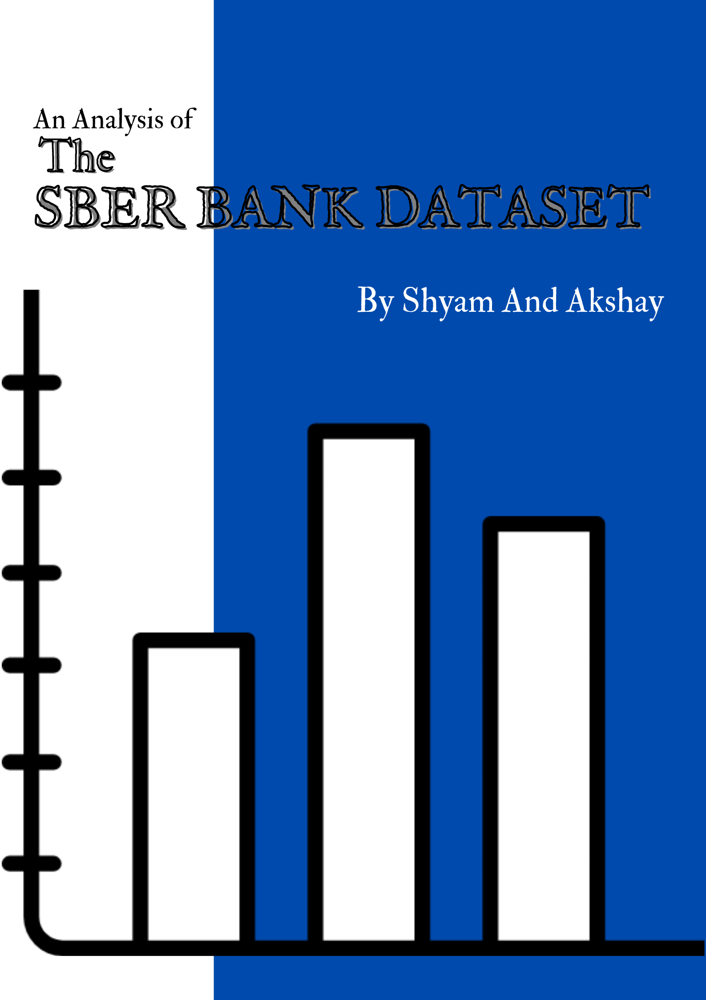

### <u>Table of contents</u>
1. [Abstract](#Abstract)

2. [Methodology](#Methodology)

3. [Background](#Background)

4. [Application](#Application)

<a id='Abstract'><h3>Abstract</h3></a>
   The intention is to do study the variables in the Sber bank dataset, and drawing inferances from each variable and trying to understand it well, while also comparing it with the target, **doc_price** to see if they are related, and if so, how.</p>
   We intend to find these realtionships by applying statistical tests. 

<a id='Background'><h3>Background</h3></a>

<a id='Methodology'><h3>Methodology</h3></a>

In [1]:
import numpy as np
import pandas as pd

from scipy import stats
from scipy.stats import pearsonr
from scipy import stats

import plotly.express as px

import ipywidgets as widgets
from ipywidgets import interact, interact_manual



df = pd.read_csv('Data/train.csv')

In [2]:
import numpy as np
import pandas as pd

from scipy import stats
from scipy.stats import pearsonr
from scipy import stats

import plotly.express as px

import ipywidgets as widgets
from ipywidgets import interact, interact_manual



df = pd.read_csv('Data/train.csv')

def UnivariateDataAnalysis_Num(column, tgt = 'price_doc'):
    
    na = df[column].isnull().sum()
    mini = df[column].min()
    mean = df[column].mean()
    median = df[column].median()
    mode = df[column].mode()[0]
    maxi = df[column].max()

    hist_title = 'The distribution of ' + column 
    fig1 = px.histogram(x = df[column],
                 template = 'plotly_dark',
                 opacity = 0.85,
                 color_discrete_sequence = ['rgb(4,217,255)'],
                 title = hist_title,
                 marginal = 'violin',
                        width = 500,
                  height = 500
                 )
    fig2 = px.box(y = df[column],
                  template = 'plotly_dark',
                  title = hist_title,
                  color_discrete_sequence =['rgb(4,217,255)'],
                  width = 500,
                  height = 500
                 )
    if na != 0:

        print(f'{column} has {na} missing values.')
        print(f'Which is {round((na/df.shape[0])*100, 2)}% of the data.\n')
    else:
        print(f'{column} has no missing values.\n')

    print('The summary of the distribution is:')
    print(f'Min: {mini}')
    print(f'Max: {maxi}')
    print(f'Mean: {mean}')
    print(f'Median: {median}')
    print(f'Mode: {mode}\n')

    print('Shapio-Wilk Test: ')
    print('Null Hypothesis: The distribution is normally distributed.')
    print('Alt Hypothesis: The distribution is not normally distributed.')
    print('Level of significance: 0.05\n')
    shapiro_test = stats.shapiro(df[column])
    p = shapiro_test.pvalue
    print(f'The P-value is: {p}')
    if p < 0.05:
        print('Result: Reject Null hypothesis, NOT normally distributed.\n')
    else:
        print('Result:  Fail to Reject null hypothesis, normally distributed.\n')
    print('Visualized;')

    fig1.show()
    fig2.show()
    
    #bivariate begins here;
    df1 = df.dropna()
    target = df1[tgt]
    variable = df1[column].dropna()
    
    corri = pearsonr(target, variable)
    df1 = None
    print(f'The correlation between {column} and {tgt} is {corri[0]}.')
    
    fig3 = px.scatter(x = df[column],
               y = df[tgt],
                      template = 'plotly_dark',
                      opacity = 0.85,
                      title = f'Scatter: {column} and {tgt}'
              )
    fig3.show()
    
    
    

def UnivariateDataAnalysis_cat(column, tgt = 'price_doc'):
    
    na = df[column].isnull().sum()
    mode = df[column].mode()[0]
    unique = df[column].dropna().unique().tolist()
    cardi = len(unique)
    
    if na != 0:

        print(f'{column} has {na} missing values.')
        print(f'Which is {na/df.shape[0]}% of the data.\n')
    else:
        print(f'{column} has no missing values.\n')
        
    fig1 = px.histogram(x = df[column], 
                        template = 'plotly_dark',
                        opacity = 0.85
                       )
        
    print('Summary of the Varaiable:')
    print(f'Mode:" {mode}')
    print(f'Cardinality: {cardi}')
    print(f'Unique values are: {unique}')
    
    print('Visualized:')
    fig1.show()
    
    print('Shapio-Wilk Test: ')
    print('Null Hypothesis: The distribution is normally distributed.')
    print('Alt Hypothesis: The distribution is not normally distributed.')
    print('Level of significance: 0.05\n')
    shapiro_test = stats.shapiro(df['price_doc'])
    p = shapiro_test.pvalue
    print(f'The P-value is: {p}')
    if p < 0.05:
        print('Result: Reject Null hypothesis, NOT normally distributed.\n')
        
        created = []

        print(type(unique))
        for i in unique:
            created.append(list(df[df[column] == i]['price_doc']))
            
            
        print('The Kruskal-Wallis H-test:')
        print('Null hypothesis: The population median of all of the groups are equal.')
        print('Alternative Hypothesis: The population median of all of the groups are equal.')
        stat, p = stats.kruskal(* created)
        a = 1
        for i in created:
            
            print(f'The median of the group-{a} is: {np.median(np.array(i))}')
            a += 1
        print(f'RESULTS: The test stat is {stat}, pvalue is {p}.')
        if p < 0.05:
            print('Reject Null Hypothesis, Median are not equal.')
        else:
            print('Fail to reject Null Hypothesis, Medians of the groups are equal.')
        
        
    else:
        print('Result:  Fail to Reject null hypothesis, normally distributed.\n')
    print('Visualized;')
    
    fig2 = px.histogram(x = df[column], y = df['price_doc'],
                        template = 'plotly_dark',
                        opacity = 0.85
                       )
    fig3 = px.box(x = df[column], 
                  y = df['price_doc'],
                  template = 'plotly_dark'
                 )
    fig2.show()
    fig3.show()
    
    
def plot_hist(vari):
    fig = px.histogram(data_frame = df,
             x = vari,
             template = 'plotly_dark',
             opacity = 0.85,
             color_discrete_sequence = ['rgb(128,0,0)'],
             title = vari,
             marginal = 'violin'
                   )
    fig.show()

def plot_scatter(vari):
    fig3 = px.scatter(data_frame = df,
                      x = vari,
                      y = 'price_doc',
                      template = 'plotly_dark',
                      opacity = 0.85,
                      title = f'Scatter: {vari} and price_doc',
                      color_discrete_sequence = ['rgb(128,0,0)']
              )
    fig3.show()

<a id="Application"><h3>Application</h3></a>

### ID

* The ID column is the transaction id.
* It contains 30471 unique values, which indicates a unique value for each ro in the dataset.
* It can be considered a column ideal for the primary key, and though it is numerical in nature, it cannot be used as a numerical variable.
* The least value is 1 and it goes upto 30471.


### Timestamp

* The timestamp is the date of the transaction.

* It is in the format yyyy-mm-dd.

* It contains 1161 unique dates.

* The most repeated date is 2014-12-16.

* The dates span between 2011-08-20 and 2015-06-30.

In [3]:
plot_hist('timestamp')

###### <u>Observations</u>: 

* There appear to be a drop in the number of transactions some time around the end of December to the mid of Jan, which seem to be the low points.

* The number of transactions grow up untill the drop in dec 2014, after which the rise was not as same as the previous years.


### full_sq
* Total area in square meters, including loggias, balconies and other non-residential areas.
* It is a numberical variable.
* The minimum full_ssq is 0, and has no missing values. 
* The values range from 0 and 5326.
* The mean value is 54.21 while the median is 49.0 and the mode is 38.
* The mean, being towards the right of the median, we can understand that the variable is not distributed normally, and has a rightward tail.
* This is confirmed by the Shapiro wilk test, also indicating the distribution is not normal.
* There is a single value; 5326sqft which is an outlier.


In [4]:
plot_hist('full_sq')

In [5]:
plot_scatter('full_sq')

#### <u>With the Target</u>

* The target and the variable has a somewhat positive correlation, indicating, that there is a rise in price ith a rise in square meters. 

* corr =  0.675454571584285 indicates a mild positive correlation.
* The oulier appears to be false data, as we can see, though the squareft is the lagerst, the price is quite low. This could also be a location where prices are low.
* There is also an outlier where the price is really very high whwile the square foot is really low, this might also be a location based thing, but e ill need to check these values to amke sure and decide weather to remove them from the dataset or keep them.

### life_sq

* Total livealble areas in sq meters.
* 6383 values are missing, which accounts to almost 21% of the data.
* The values span from 0.0 to 7478, the mean is 34.4 and the median is 30, while the mode is 19.
* We can see that the mean is to the right of the median indicating a right tail and a non- normal distribution.
* The shapiro wilk test shows that it is normally distributed, but it might me due to the fact that the p-value is unreliable for values over 500.
* There is an outlier, proably the same row as the outlier from full_sq.


In [6]:
plot_hist('life_sq')

In [7]:
plot_scatter('life_sq')

##### <u>With the Target;</u>

* The variable and the target, have a somewhat positive correlation.
* 0.52 is the correlation score indicating a low positive relationship.
* The same two outliers are visible in the same position, one with higher life sq and a very low price and a value with very lo life sq and very high price.

### floor

* Floor of the building in which the appartment is.
* It is the count of floors, therefore making it a numerical discrete vairable.
* There are 167 missing values.
* The cardinality of the variable is 41.
* The most common value in floors is 3.
* There is an outlier, which is 77 floors ! probally the same value that appeared as an outlier in the previous cases.
* Majority of the houses are on the lower side of the floors.

In [8]:
plot_hist('floor')

##### With the target:

* Given the target is not normally distributed, we will be performing a kruskal wallis test and compairing the medians instead of the means, the results of which are that the meadians of the floors are different from each other.
* This means that the price of houses differer significantly by floors.

* We can infer from the histogram that the majority of funds are towards the lower floors.

### max_floor

* number of floors in the building.
* 9572 values are missing, which aacounts to 0.31 % of the dataset.
* Is also a discrete variable, it is the count of floors.
* Cardinalty of 49 and the most common number of floors is 17.


In [9]:
plot_hist('max_floor')

#### With the target:

* The median values are significantly different among different floors.

* Indicating that the floor prices are different for buildings with different floors.

* 

### material

* wall material
* Has 9,572 missing values, which accounts to 0.31% of the total data.
* category 1 is the most popylar of the wawll materials.
* The variable has a cardinality of 6 unique values.

In [10]:
plot_hist('material')

##### With the target:
* The median of the data are different for different floors.
* Indicating that the wall material would be helpful in predicting the price_doc

### build_year

In [11]:
dates = df['build_year'].dropna()

In [12]:
dates = pd.to_datetime(dates).dt.strftime('%Y')

In [13]:
dates.max()

'1970'

In [14]:
dates = df['build_year'].replace(.0, '').dropna()

In [15]:
dates

8056     1907
8135     1980
8153     2014
8154     1970
8175     1982
         ... 
30464    2017
30466    1975
30467    1935
30469    2003
30470    1968
Name: build_year, Length: 16866, dtype: object

In [17]:
dates

8056     1907
8135     1980
8153     2014
8154     1970
8175     1982
         ... 
30464    2017
30466    1975
30467    1935
30469    2003
30470    1968
Name: build_year, Length: 16866, dtype: object

* It is the year the building waws built.
* It has 119 different years.
* They years span from 1970 to

### num_room

* number of living rooms.
* The most common number of rooms is 2 and 1 being the secon highest.
* Cardinality is 13.
* The max number of rooms is 19, and 17 and we have one of each.
* We also have a data point with 0 rooms we could compare the total sq and living sq to see if there is a structure or if it's just a piec of land, of wrong data.
* The entries with 17 and 19 room seem to be incorrect as their count and sq meters of total and living space dont quite add up, when compared to other houses in a lower range.

In [21]:
plot_hist('num_room')

##### <u>with the target </u>

* When compared to the target, the price of houses with different rooms are significantly different.
* Meaning that this column would be good for prediction, but given the cardinality, we would have to choose ways of encoding it other than OHBE.

### kitch_sq

* kitchen area probably same unit Sq m.
* Has 9572 missing values, which account for 31.41% of the data.
* The values range from 0.0 to 2014 sqm.
* The mean area is 6.4 sqm.
* Mode is 1.0
* Three outliers, one with 620 sqm, 1974 sqm and 2014 sqm. These are probaby incorrect entries. 
* 1974 and 2014 appear to be years, but given that both of these values for years are filled up, they might be from some other data point.
* It would be best to drop these values from the data set, if we are not able to trace the real values.

In [22]:
plot_hist('kitch_sq')

##### <u>With Target</u>

* The target and the variable have a very mild positive correlation.
* Given the very mild correlation and 31 % missing values, it would be best to drop this column.

### state

* The condition of the appartment.
* has 13559 missing values, which account for 0.44 % of the total data.
* The most frequent value is 2 and 3 is close second.
* Cardinality is 5.
* Has an outlier with the value of 33. It is probably a wrong entry. Could be 3, but incorrectly entered as 33.

In [23]:
plot_hist(df.columns[10])

##### <u> With the Target</u>

* The Medians of the different clases are different and the variable would be really useful for prediction.
* Given the low cardinality, we can use OHB encoding, wwhich would be perefect for categorical variables !
* As of the missing values, we could fill them wwith the mode, given there are only a few.


### product_type

* owner-occupier purchase or investment
* Indicates if the appartment is ocupation purchase or investment.
* Cardinality is 2
* Majority of the data are investment.
* No missing values.


In [24]:
plot_hist(df.columns[11])

##### <u>With The Target:</u>
* There is a statistically significant difference between the medians of both the values.
* Also given it has very low cardinality and no missing values, 1hb encoding would be ideal and given that the medians are different, it would also aid in prediction.

### sub_area
* name of the district
* Contains a total of 146 unique values.
* There are no missing values.
* The mode is Poselenie Sosenskoe.

In [25]:
plot_hist('sub_area')

##### <u>with the target: </u>

* There is a statistically significat difference in the median values of the different districts.
* Given the high cardinality, we would have to choose other ways of encoding them other than one hot bit encoding. 


### area_m
* Area mun. area, sq.m.
* Can be considered a numerical variable as it the area.
* Has no missing values.
* The maximum area is 2081627.761 and the minimum value is 206071809.2.
* The mean area is 17657051.42 while the median is 10508030.1 and the mode is 66772450.69
* The data is not normally distributed. 
* There are a few outliers.

In [26]:
plot_hist('area_m')

In [27]:
plot_scatter('area_m')

#### <u>With the target</u>
* It has almost no correlation with the target and hence can be excluded from the predictor variables.

### raion_popul

* Number of municipality population. district
* Has no missing values
* The minimum population is 2546 and the maximum is 247469 while the mean population is 84056.
* There are a total of 146 different population values.

In [32]:
plot_hist('raion_popul')

##### With the target:

* The median values of price_doc are different for different lables of population, and hence can be considered for the model as it also has no missing values.

In [38]:
df.columns[15]

'green_zone_part'

### green_zone_part

* green_zone_part is the ratio of Proportion of area and greenery in the total area.
* It has no missing values.
* The minimum of the ratio is 0.001879375 and the max is 0.85292.
* There are 146 different values for the ratio.

In [42]:
plot_hist('green_zone_part')

##### With the target:
 * The medians of the price doc are different for different values of population, and hence it will be a great pick for the model, also given that it has no missing values.
 

### indust_part

* Ratio of Share of industrial zones in area of and the total area.
* Has no missing values.
* The minimum value is 0.0 and the maximum value is 0.522.
* It has 132 different ratio values.
* The most common value is 0.0.
* The mean value is 0.11887


In [46]:
plot_hist('indust_part')

##### With the target:

* The medians of the target are different for each label, and hence this value would be a good fit for the model, also given that it has no missing values.

### children_preschool

* The number of preschool age population in the area.
* The variable has no missing values.
* The minimum of the population is 175 And the max is 19223.
* 

In [50]:
UnivariateDataAnalysis_Num('children_preschool')

children_preschool has no missing values.

The summary of the distribution is:
Min: 175
Max: 19223
Mean: 5140.026156017197
Median: 4857.0
Mode: 656

Shapio-Wilk Test: 
Null Hypothesis: The distribution is normally distributed.
Alt Hypothesis: The distribution is not normally distributed.
Level of significance: 0.05

The P-value is: 0.0
Result: Reject Null hypothesis, NOT normally distributed.

Visualized;


/home/kamla/anaconda3/lib/python3.7/site-packages/scipy/stats/morestats.py:1681: UserWarning:

p-value may not be accurate for N > 5000.



The correlation between children_preschool and price_doc is -0.07581623984346567.
